## 1. Import Library & Read Dataset Image

In [56]:
# import beberapa library yang akan dibutuhkan
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2
from glob import glob
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential

In [57]:
# Memanggil semua data gambar dengan keempat kategori yang berbeda yang ada di dalam folder COVID-19_Radiography_Dataset
covid19_images_data = "COVID-19_Radiography_Dataset/COVID"
lung_opacity_images_data = "COVID-19_Radiography_Dataset/Lung_Opacity"
normal_images_data = "COVID-19_Radiography_Dataset/Normal"
pneumonia_images_data = "COVID-19_Radiography_Dataset/Viral Pneumonia"

In [58]:
"""
Memanggil semua gambar dengan seluruh eksistensi gambar (.png/.jpg/.jpeg) yang ada
di dalam keempat DataFrame yang menampung data-data gambar berdasarkan kategorinya
"""
# Data gambar paru-paru manusia yang terkena virus covid-19
covid19_data = glob(covid19_images_data + "/*")

# Data gambar paru-paru dengan kategori penyakit yaitu lung opacity
lung_opacity_data = glob(lung_opacity_images_data + "/*")

# Data gambar dengan kategori paru-paru normal
normal_data = glob(normal_images_data + "/*")

# Data gambar dengan penyakit paru-paru denga kategori pneumonia
pneumonia_data = glob(pneumonia_images_data + "/*")

Keterangan:

Pada script diatas terdapat code dengan "/*" yang menandakan untuk mencocokan segala jenis eksistensi file yang ada di dalam folder tersebut untuk dipanggil ke dalam code. Sebagai contoh jika kita ingin hanya memanggil file dengan eksistensi .txt maka bisa gunakan script "/*.txt" atau jika ingin memanggil file yang hanya bereksistensi .jpg (karena pada eksperimen kali ini menggunakan data images) maka kita bisa menggunakan script "/*.jpg".

In [59]:
# Melihat jumlah masing-masing data gambar dari keempat kategori paru-paru (normal, covid-19, lung opacity atau pneumonia)
print("Nama Ketiga File dari Gambar Covid-19: ", covid19_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Covid-19: ", len(covid19_data), "\n")

print("Nama Ketiga File dari Gambar Lung Opacity: ", lung_opacity_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity: ", len(lung_opacity_data), "\n")

print("Nama Ketiga File dari Gambar Normal: ", normal_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Normal: ", len(normal_data), "\n")

print("Nama Ketiga File dari Gambar Pneumonia: ", pneumonia_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Pneumonia: ", len(pneumonia_data))

Nama Ketiga File dari Gambar Covid-19:  ['COVID-19_Radiography_Dataset/COVID\\COVID-1.png', 'COVID-19_Radiography_Dataset/COVID\\COVID-10.png', 'COVID-19_Radiography_Dataset/COVID\\COVID-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Covid-19:  1797 

Nama Ketiga File dari Gambar Lung Opacity:  ['COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-1.png', 'COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-10.png', 'COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity:  2000 

Nama Ketiga File dari Gambar Normal:  ['COVID-19_Radiography_Dataset/Normal\\Normal-1.png', 'COVID-19_Radiography_Dataset/Normal\\Normal-10.png', 'COVID-19_Radiography_Dataset/Normal\\Normal-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Normal:  2000 

Nama Ketiga File dari Gambar Pneumonia:  ['COVID-19_Radiography_Dataset/Viral Pneumonia\\Viral Pneumonia-1.png', 'COVID-19_Radiography_Dataset/Viral Pneumonia\\Viral Pneumoni

In [60]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu Normal dan Pneumonia
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Normal"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------")

# Gambar x-ray dengan urutan file ke-1.798
normal_img1798_resolution = Image.open(str(normal_data[1798]))
width, height = normal_img1798_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-1.001
normal_img1001_resolution = Image.open(str(normal_data[1001]))
width, height = normal_img1001_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-862
normal_img862_resolution = Image.open(str(normal_data[862]))
width, height = normal_img862_resolution.size

print("Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Pneumonia"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------")

# Gambar x-ray 377
pneumonia_img377_resolution = Image.open(str(pneumonia_data[377]))
width, height = pneumonia_img377_resolution.size

print("Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 784
pneumonia_img784_resolution = Image.open(str(pneumonia_data[784]))
width, height = pneumonia_img784_resolution.size

print("Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 1.008
pneumonia_img1008_resolution = Image.open(str(pneumonia_data[1008]))
width, height = pneumonia_img1008_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------
Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------
Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah: 299x299


In [61]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu covid-19 dan Lung Opacity
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Covid-19"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------")

# Gambar x-ray pertama
covid19_img1_resolution = Image.open(str(covid19_data[0]))
width, height = covid19_img1_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-53
covid19_img53_resolution = Image.open(str(covid19_data[53]))
width, height = covid19_img53_resolution.size

print("Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-67
covid19_img67_resolution = Image.open(str(covid19_data[67]))
width, height = covid19_img67_resolution.size

print("Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Lung Opacity"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------")

# Gambar x-ray kelima
lungopacity_img5_resolution = Image.open(str(lung_opacity_data[5]))
width, height = lungopacity_img5_resolution.size

print("Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 39
lungopacity_img39_resolution = Image.open(str(lung_opacity_data[39]))
width, height = lungopacity_img39_resolution.size

print("Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 119
lungopacity_img119_resolution = Image.open(str(lung_opacity_data[119]))
width, height = lungopacity_img119_resolution.size

print("Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------
Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------
Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah: 299x299


## 2. Eksplorasi Data Gambar berdasarkan Keempat Kategori dari Paru-Paru

### 2.1. Menampilkan Salah Satu Gambar dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.1.1. Gambar X-Ray Paru-Paru Covid-19

COVID-19_Radiography_Dataset/COVID\COVID-1.png


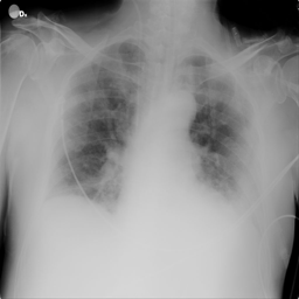

In [62]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena virus covid-19
covid_image = list(covid19_data)
print(covid_image[0])

# Membuka gambar dengan indeks array pertama atau dengan kata lain melihat gambar pertama dari paru-paru covid-19
Image.open(str(covid_image[0]))

#### 2.1.2. Gambar X-Ray Paru-Paru Lung Opacity

COVID-19_Radiography_Dataset/Lung_Opacity\Lung_Opacity-1000.png


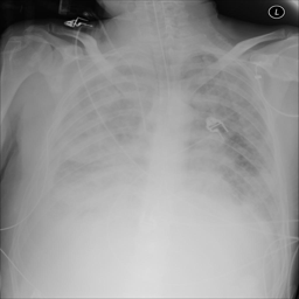

In [63]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit lung opacity
lung_opacity_image = list(lung_opacity_data)
print(lung_opacity_image[3])

"""
Membuka gambar dengan indeks array ketiga dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar keempat dari paru-paru yang terindikasi penyakit dengan kategori lung opacity
"""
Image.open(str(lung_opacity_image[3]))

#### 2.1.3. Gambar X-Ray Paru-Paru Normal

COVID-19_Radiography_Dataset/Normal\Normal-1003.png


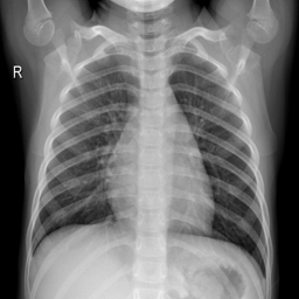

In [64]:
"""
Menampilkan salah satu gambar dari paru-paru normal
(yang tidak terindikasi penyakit apapun seperti covid-19/lung opacity dan pneumonia)
"""
normal_lung_image = list(normal_data)
print(normal_lung_image[6])

"""
Membuka gambar dengan indeks array keenam dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ketujuh dari paru-paru yang memliki kategori normal
"""
Image.open(str(normal_lung_image[6]))

#### 2.1.4. Gambar X-Ray Paru-Paru Pneumonia

COVID-19_Radiography_Dataset/Viral Pneumonia\Viral Pneumonia-1015.png


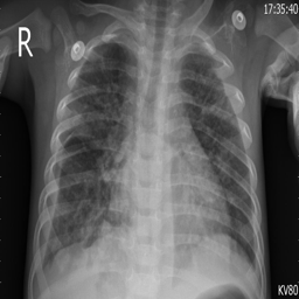

In [65]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit pneumonia
pneumonia_lung_image = list(pneumonia_data)
print(pneumonia_lung_image[19])

"""
Membuka gambar dengan indeks array 19 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ke-20 dari paru-paru yang terindikasi penyakit dengan kategori pneumonia
"""
Image.open(str(pneumonia_lung_image[19]))

### 2.2. Menampilkan Beberapa Gambar yang Membentuk Horizontal (Berdasarkan Baris) dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.2.1 Kumpulan Gambar dari Data X-Ray Covid-19

Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: 


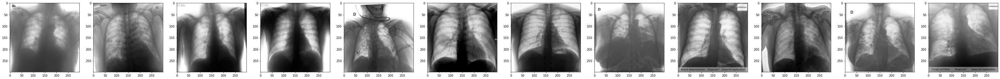

In [66]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi covid-19 dengan cara melakukan perulangan
for covid in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: ")
    covid = list(covid19_data)
    covid_path = [k for k in covid19_data]
    
    for i in range (12):
        covid_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(covid_path[i], color_mode="grayscale"))
        axs[i].imshow(covid_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for covid in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru terkena covid. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru covid-19 dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "covid" yang berisikan list dari variabel "covid19_data" memiliki tujuan yaitu variabel "covid" mengambil semua isi data yang ada di dalam variabel "covid19_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "covid_path" terkoneksi atau sangat berkaitan dengan variabel "covid_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.2. Kumpulan Gambar dari Data X-Ray Lung Opacity

Kumpulan Gambar Paru-Paru yang Lung Opacity: 


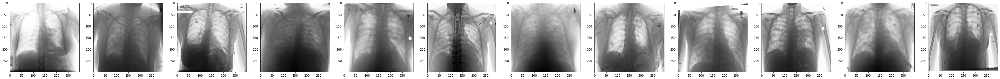

In [67]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi lung opacity dengan cara melakukan perulangan
for lung_opacity in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Lung Opacity: ")
    lungopacity = list(lung_opacity_data)
    lungopacity_path = [k for k in lung_opacity_data]
    
    for i in range (12):
        lung_opacity_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(lungopacity_path[i], color_mode="grayscale"))
        axs[i].imshow(lung_opacity_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for lung_opacity in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru lung opacity. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru lung opacity dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "lungopacity" yang berisikan list dari variabel "lung_opacity_data" memiliki tujuan yaitu variabel "lungopacity" mengambil semua isi data yang ada di dalam variabel "lung_opacity_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "lungopacity_path" terkoneksi atau sangat berkaitan dengan variabel "lung_opacity_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.3. Kumpulan Gambar dari Data X-Ray Normal

Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): 


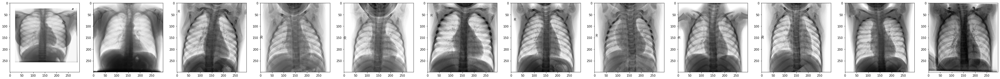

In [68]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang normal (tidak terkena apapun) dengan cara melakukan perulangan
for normal in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): ")
    normal = list(normal_data)
    normal_path = [k for k in normal_data]
    
    for i in range (12):
        normal_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(normal_path[i], color_mode="grayscale"))
        axs[i].imshow(normal_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for normal in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru normal. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru normal dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "normal" yang berisikan list dari variabel "normal_data" memiliki tujuan yaitu variabel "normal" mengambil semua isi data yang ada di dalam variabel "normal_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "normal_path" terkoneksi atau sangat berkaitan dengan variabel "normal_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.4. Kumpulan Gambar dari Data X-Ray Pneumonia

Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: 


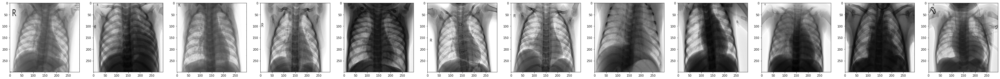

In [69]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi penyakit pneumonia dengan cara melakukan perulangan
for pneumonia in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: ")
    pneumonia = list(pneumonia_data)
    pneumonia_path = [k for k in pneumonia_data]
    
    for i in range (12):
        pneumonia_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(pneumonia_path[i], color_mode="grayscale"))
        axs[i].imshow(pneumonia_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for pneumonia in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru pneumonia. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru pneumonia dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "pneumonia" yang berisikan list dari variabel "pneumonia_data" memiliki tujuan yaitu variabel "pneumonia" mengambil semua isi data yang ada di dalam variabel "pneumonia_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "pneumonia_paths" terkoneksi atau sangat berkaitan dengan variabel "pneumonia_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

### 2.3. Menampilkan 35 Gambar Hasil X-Ray Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.3.1. Gambar X-Ray dari Paru-Paru dengan Status Covid-19

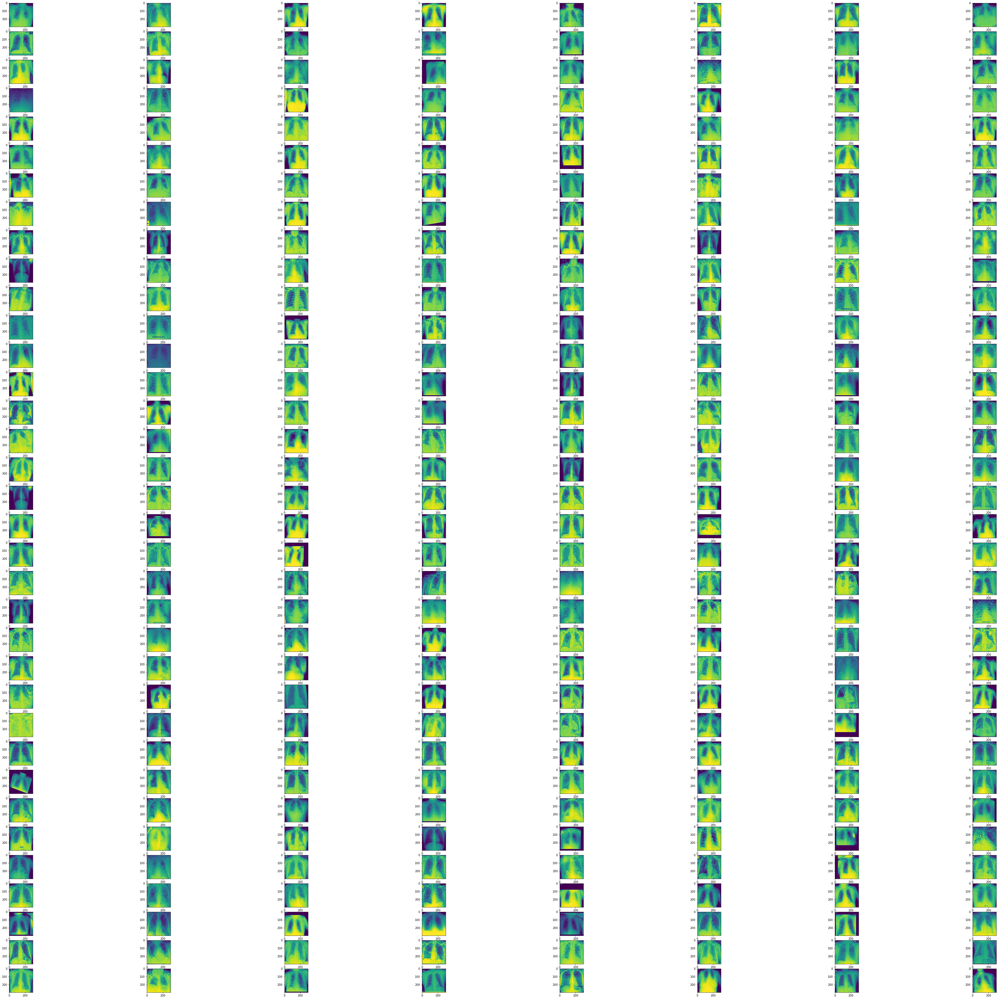

In [70]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena virus covid-19
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_covid_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_covid_images + 1)
    images = plt.imread(covid19_data[multiple_covid_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.2. Gambar X-Ray dari Paru-Paru dengan Status Long Opacity

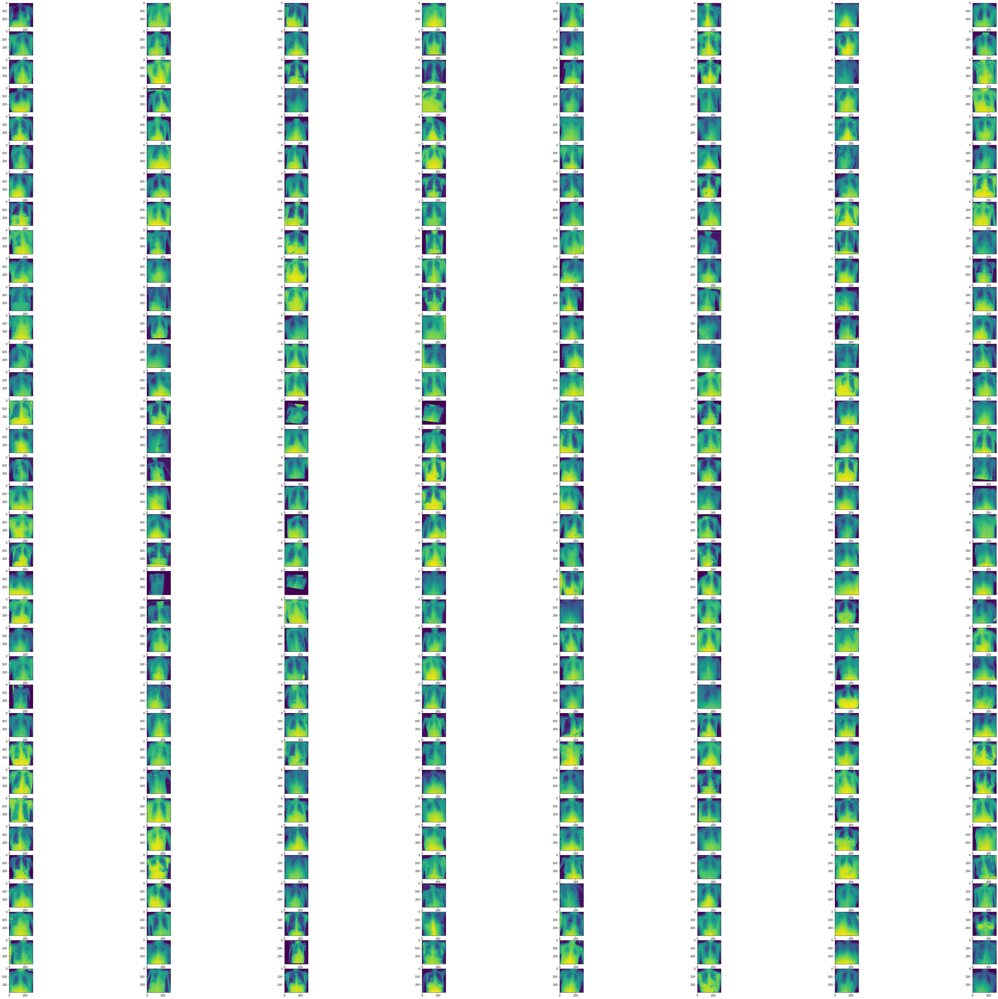

In [71]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena lung opacity
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_lung_opacity_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_lung_opacity_images + 1)
    images = plt.imread(lung_opacity_data[multiple_lung_opacity_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.3. Gambar X-Ray dari Paru-Paru dengan Status Normal

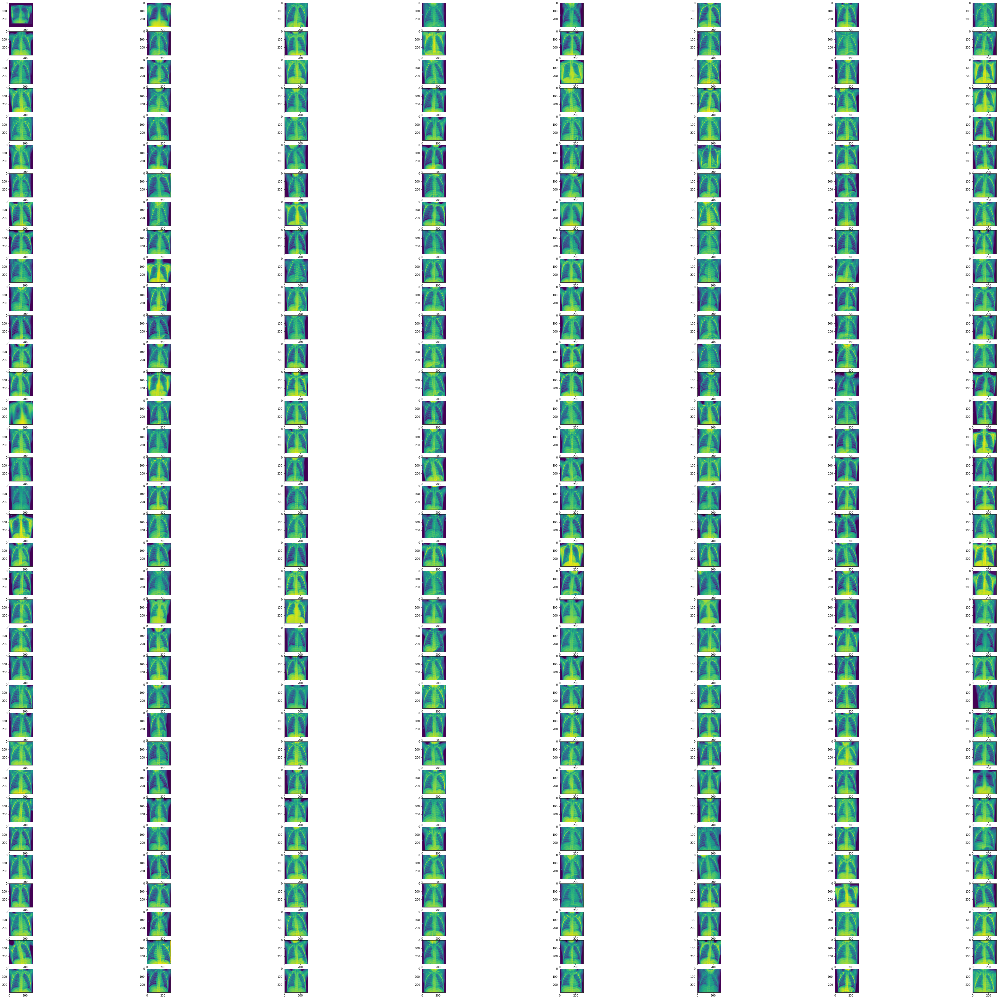

In [72]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru dengan status/kategori normal
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_normal_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_normal_images + 1)
    images = plt.imread(normal_data[multiple_normal_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.4. Gambar X-Ray dari Paru-Paru dengan Status Pneumonia

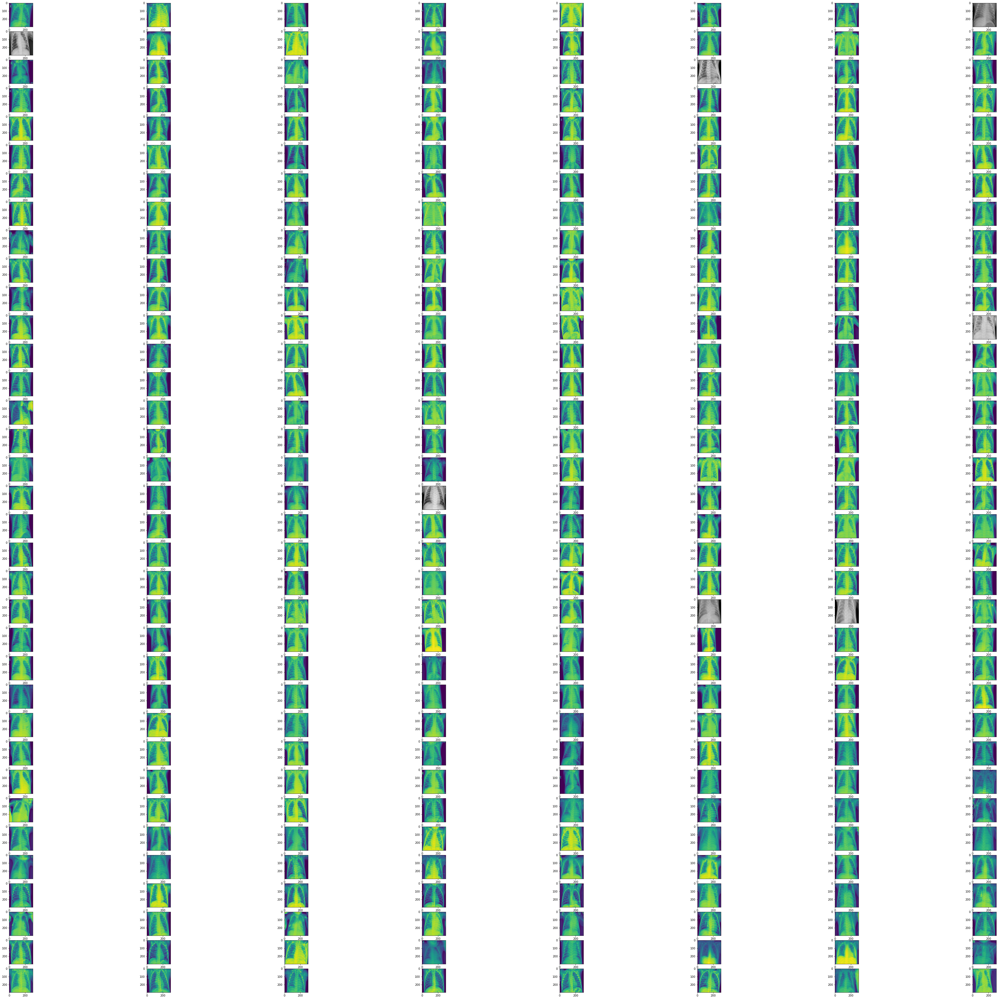

In [73]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena atau dengan status pneumonia
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_pneumonia_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_pneumonia_images + 1)
    images = plt.imread(pneumonia_data[multiple_pneumonia_images])
    plt.imshow(images)
    
plt.show()

## 3. Image Preprocessing

In [74]:
# Membuat variabel training dan validasi yang mencakup data-data dari variabel DataFrame (mencakup gambar per kategori)

"""
Membuat variabel baru yaitu variabel training yang mencakup
masing-masing direktori gambar x-ray per status kategori paru-paru.
Variabel/direktori training ini berfungsi untuk melatih data dengan neural networks nantinya
"""
covid19_train_dir = os.path.join(covid19_images_data)
lung_opacity_train_dir = os.path.join(lung_opacity_images_data)
normal_train_dir = os.path.join(normal_images_data)
pneumonia_train_dir = os.path.join(pneumonia_images_data)

"""
Membuat variabel baru yaitu variabel validation yang mencakup
masing-masing direktori gambar x-ray per status kategori paru-paru.
Variabel/direktori validation ini berfungsi untuk memvalidasi data setelah proses latihan dengan algoritma
"""
covid19_validation_dir = os.path.join(covid19_images_data)
lung_opacity_validation_dir = os.path.join(lung_opacity_images_data)
normal_validation_dir = os.path.join(normal_images_data)
pneumonia_validation_dir = os.path.join(pneumonia_images_data)

Fungsi dari os.path.join(nama variabel) adalah untuk menggabungkan satu/lebih komponen direktori dataset. Pada script/code diatas dapat diketahui jika variabel covid19_images_data, dll, (contoh variabel DataFrame yang digunakan untuk menampung/memanggil data gambar pada eksperimen kali ini) dipanggil dan ditampung pada sebuah variabel yang menjadi data training. Jadi akan ada 4 data training yang berisikan data-data gambar dari hasil penggabungan (join) variabel DataFrame yang berbeda-beda. Konsep tersebut sama berlakunya dengan data validation.

In [75]:
"""
Membuat data training dan data testing berdasarkan keempat kategori
atau status dari data gambar x-ray paru-paru seperti covid-19, lung opacity, normal dan pneumonia
"""

# Data training
covid19_train = os.path.join(covid19_images_data)
lung_opacity_train = os.path.join(lung_opacity_images_data)
normal_lung_train = os.path.join(normal_images_data)
pneumonia_train = os.path.join(pneumonia_images_data)

# Data testing
covid19_test = os.path.join(covid19_images_data)
lung_opacity_test = os.path.join(lung_opacity_images_data)
normal_lung_test = os.path.join(normal_images_data)
pneumonia_test = os.path.join(pneumonia_images_data)

In [76]:
"""
Melalukan proses pemisahan/pembagian data menjadi data training dan data testing
dengan proporsi persentase sebesar 30% untuk data testing dan 70% untuk data training
serta membuat validasi data gambar per masing-masing kategori/status paru-paru
"""

# Membuat direktori data gambar x-ray paru-paru covid-19 untuk data train dan data validation
x_train_covid19_dir, x_test_covid19_dir, y_train_covid19_dir, y_test_covid19_dir = train_test_split(
    os.listdir(covid19_train), os.listdir(covid19_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru lung opacity untuk data train dan data validation
x_train_lung_opacity_dir, x_test_lung_opacity_dir, y_train_lung_opacity_dir, y_test_lung_opacity_dir = train_test_split(
    os.listdir(lung_opacity_train), os.listdir(lung_opacity_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru normal untuk data train dan data validation
x_train_normal_dir, x_test_normal_dir, y_train_normal_dir, y_test_normal_dir = train_test_split(
    os.listdir(normal_lung_train), os.listdir(normal_lung_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru pneumonia untuk data train dan data validation
x_train_pneumonia_dir, x_test_pneumonia_dir, y_train_pneumonia_dir, y_test_pneumonia_dir = train_test_split(
    os.listdir(pneumonia_train), os.listdir(pneumonia_test), test_size = 0.3, random_state=29)

Berikut adalah penjelasan dari proses split validation:

1. os.listdir(covid19_train), os.listdir(lung_opacity_train), os.listdir(normal_lung_train), os.listdir(pneumonia_train): Merupakan sebuah variabel yang memiliki status training (data untuk melatih model deep learning). Dalam pengujian kali ini, terdapat 4 variabel training yang masing-masing keempat variabel tersebut berisikan data gambar paru-paru yang terkena virus covid-19, penyakit lung opacity, penyakit pneumonia atau paru-paru normal.
2.  os.listdir(covid19_test),  os.listdir(lung_opacity_test),  os.listdir(normal_lung_test),  os.listdir(pneumonia_test): Merupakan sebuah variabel yang memiliki status testing yang berarti data-data pada variabel ini (variabel test) bertujuan untuk menguji model deep learning dengan diberikan beberapa data-data gambar baru yang sebelumnya belum diketahui oleh model. Sama seperti pada variabel training, variabel testing memiliki 4 variabel yang masing-masing keempat variabel tersebut berisikan data gambar paru-paru yang terkena virus covid-19, penyakit lung opacity, penyakit pneumonia atau paru-paru normal.
3. test_size: Nilai presentase atau nilai proporsi dalam pembagian data menjadi data training dan data testing. Dalam pengujian ini saya memakai nilai presentase test_size sebesar 0.3 yang dimana ukuran dari variabel testing mencapai 30% dan variabel train mencapai 70%.
4. random_state: Fungsi ini berfungsi untuk menetapkan nilai supaya ketika setiap kali codingan dijalankan maka nilai yang ada di data training dan data testing akan selalu tetap dan nilainya dan tidak berubah-ubah sedangkan jika di proses split validation ini tidak menetapkan nilai random_state maka setiap codingan dijalankan maka nilai baru akan teracak kembali di data training dan data testing sehingga akan memiliki nilai yang berbeda-beda setiap saat codingan dijalankan. Dalam menetapkan nilai random_state tidak ada ketentuan nilai yang pasti (bebas menentukan nilai bilangan bulat) namun dalam pengujian kali ini saya menetapkan nilai 29 di random_state.

In [77]:
x_train = np.concatenate((x_train_covid19_dir, x_train_lung_opacity_dir, x_train_normal_dir, x_train_pneumonia_dir), axis=0)
y_train = np.concatenate((y_train_covid19_dir, y_train_lung_opacity_dir, y_train_normal_dir, y_train_pneumonia_dir), axis=0)
x_test = np.concatenate((x_test_covid19_dir, x_test_lung_opacity_dir, x_test_normal_dir, x_test_pneumonia_dir), axis=0)
y_test = np.concatenate((y_test_covid19_dir, y_test_lung_opacity_dir, y_test_normal_dir, y_test_pneumonia_dir), axis=0)

Dari script/code diatas diketahui bahwa terdapat code np.concatenate yang berfungsi untuk menggabungkan array NumPy/beberapa variabel ke dalam 1 variabel universal yang nantinya berguna untuk tujuan pemodelan dengan suatu algoritma. Pada script diatas, saya menggunakan fungsi concatenate untuk menggabungkan beberapa variabel menjadi 4 variabel utama yaitu untuk data training adalah x_train dan y_train sedangkan data testing adalah variabel x_test dan y_test.

Variabel x_train memiliki seluruh data yang memiliki status TRAINING yang sebelumnya sudah dideklarasikan yaitu x_train_covid19_dir, x_train_lung_opacity_dir, x_train_normal_dir, x_train_pneumonia_dir yang masing-masing diisi oleh gambar dari keempat kategori x-ray paru-paru. Konsep tersebut juga berlaku pada variabel y_train, x_test dan y_test yang mana masing-masing berisikan variabel yang sudah dideklarasikan pada proses train_test_split.

Selain itu terdapat beberapa penambahan variabel universal yang digunakan pada eksperimen kali ini dimana variabel universal ini berfungsi untuk menampung/mewadahi beberapa variabel training dan testing yang dibedakan berdasarkan keempat kategori/status. Variabel-variabel universal tersebut diantaranya:
1. x_train: Merupakan data training/data yang akan melatih menggunakan model deep learning yang akan digunakan. Variabel x_train terdiri dari kumpulan dari 4 variabel independen (variabel x) yang dibedakan berdasarkan kategori/status dari gambar paru-paru dan variabel ini, variabel x_train, yang akan dilatih selama pemodelan berlangsung.
2. x_test: Merupakan data testing atau data yang akan mengetahui performa model yang telah dilatih dengan data training. Variabel x_test terdiri dari variabel independen (variabel x) yang akan diuji dengan data training. Variabel x_test juga berisikan kumpulan dari 4 variabel independen (variabel x) yang dibedakan berdasarkan kategori/status dari gambar paru-paru dan variabel ini.
3. y_train: Merupakan data training atau data yang akan melatih menggunakan model deep learning dengan fokus utamanya adalah sebagai variabel dependen/variabel y. Variabel y_train juga terdiri dari 4 kategori gambar yaitu covid-19, pneumonia, normal dan lung opacity yang nantinya berguna sebagai variabel dependen ketika proses pemodelan berlangsung
4. y_test: Merupakan data testing atau data yang akan mengetahui performa model yang telah dilatih dengan data training. Sama seperti pada variabel y_train, variabel y_test sudah pasti berbeda dengan variabel x_test karena variabel ini, variabel y_test, terdiri dari variabel dependen (variabel y) yang akan diuji selama proses pemodelan berlangsung. Variabel y_test juga terdiri dari 4 variabel gambar yaitu y_test_covid19_dir, y_test_lung_opacity_dir, y_test_normal_dir, y_test_pneumonia_dir.

In [78]:
# Melihat ukuran pada data training dan data testing yang terbagi ke dalam 2 variabel yaitu independen dan dependen

print("Ukuran pada Data Training yang terdiri dari Variabel Independen dan Variabel Dependen:", x_train.shape, y_train.shape)

print("Ukuran pada Data Testing yang terdiri dari Variabel Independen dan Variabel Dependen:", x_test.shape, y_test.shape)

Ukuran pada Data Training yang terdiri dari Variabel Independen dan Variabel Dependen: (4998,) (4998,)
Ukuran pada Data Testing yang terdiri dari Variabel Independen dan Variabel Dependen: (2144,) (2144,)


In [79]:
"""
Melakukan proses augmentasi gambar seperti melakukan penskalaan,
rotasi gambar di dalam data training dan data testing, menggeser gambar, dll.
Hal tersebut dilakukan agar model yang mempelajari data gambar mendapatkan
banyak variasi baru karena dilakukan proses augementasi
"""

# Proses augmentasi/perubahan pada gambar untuk data training
data_train_generator = ImageDataGenerator(fill_mode="nearest", width_shift_range=0.3, brightness_range=[0.2, 1.8],
                                          rescale=1./255, shear_range=0.2, horizontal_flip=True, rotation_range=55)

# Proses augmentasi/perubahan pada gambar untuk data testing
data_test_generator = ImageDataGenerator(fill_mode="nearest", width_shift_range=0.3, brightness_range=[0.2, 1.8],
                                         rescale=1./255, shear_range=0.2, horizontal_flip=True, rotation_range=55)

Dari script diatas diketahui agar model deep learning yang saya buat dapat belajar lebih banyak variasi data maka digunakan sebuah tahapan yang bernama augmentasi/mengubah keadaan gambar seperti melakukan rotasi pada gambar, mengatur kecerahan/kegalapan pada gambar, menggeser letak gambar ke arah horizontal/vertikal, dll. Pada proses augmentasi gambar untuk eksperimen ini saya menggunakan beberapa argumen diantaranya:

1. fill_mode. Method ini berfungsi untuk mengisi piksel baru pada space piksel yang telah ditinggalkan akibat proses rotasi pada gambar. Method ini sangat berkaitan dengan argumen rotation_range.
2. rotation_range. Nilai yang dibuat pada argumen ini berfungsi untuk melakukan proses pergeseran pada suatu gambar secara acak.
3. width_shift_range. Method ini bertujuan untuk menggeser piksel gambar baik secara horizontal karena mungkin saja gambar yang kita gunakan objeknya tidak berada ditengah melainkan bisa saja berada disamping kanan/kiri/atas atau bawah.
4. horizontal_flip. Method ini berfungsi untuk membalikkan setengah gambar secara acak secara horizontal.
5. shear_range. Method ini bertujuan untuk menggeser suatu gambar dengan sudut geser yang berlawanan dari arah jarum jam dalam perhitungan derajat.
6. rescale. Method ini bersifat nilai yang digunakan untuk mengalikan data dengan nilai yang akan diberikan setelah melakukan proses transformasi.
7. brightness_range. Method ini bertujuan untuk mengatur pencerahan gambar. Method ini sangat sering digunakan dan sangat berguna karena sebagian besar objek gambar tidak akan berada dalam kondisi pencahayaan yang sempurna (bisa kurang pencahayaan atau lebih pencahayaan). Nilai pencerahan gambar juga dapat diatur dengan syarat method ini menerima dua nilai saja. Jika nilai yang digunakan adalah kurang dari nol maka pencahayaan pada gambar akan digelapkan (tergantung nilainya). Sebaliknya, jika nilai yang digunakan lebih dari 1.0 maka pencahayaan pada gambar akan ditingkatkan.

Referensi:

- https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator

- https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html

- https://www.analyticsvidhya.com/blog/2020/08/image-augmentation-on-the-fly-using-keras-imagedatagenerator/#h2_6

In [101]:
# Memasukkan image data generator ke dalam variabel train_dir & validation_dir
training_generator = data_train_generator.image_dataset_from_directory(covid19_train_dir,
                                                                       lung_opacity_train_dir,
                                                                       normal_train_dir,
                                                                       pneumonia_train_dir,
                                                                       image_size=(220, 220),
                                                                       color_mode="grayscale",
                                                                       batch_size=32,
                                                                      )

testing_generator = data_test_generator.image_dataset_from_directory(covid19_validation_dir,
                                                                     lung_opacity_validation_dir,
                                                                     normal_validation_dir,
                                                                     pneumonia_validation_dir,
                                                                     image_size=(220, 220),
                                                                     color_mode="grayscale",
                                                                     batch_size=32,
                                                                    )

AttributeError: 'ImageDataGenerator' object has no attribute 'image_dataset_from_directory'

In [54]:
"""
# Fetch Images and Class Labels from Files
covid19_labels = []
lung_opacity_labels = []
normal_labels = []
pneumonia_labels = []

covid19_images=[]
lung_opacity_images = []
normal_images=[]
pneumonia_images = []

for i in range(len(covid19_data)):
    image = cv2.imread(covid19_data[i]) # read file 
    image = cv2.resize(image,(224, 224)) # resize as per model
    covid19_images.append(image) # append image
    covid19_labels.append('CT_COVID') # append class label
    
for i in range(len(normal_data)):
    image = cv2.imread(normal_data[i])
    image = cv2.resize(image,(224, 224))
    normal_images.append(image)
    normal_labels.append('CT_Normal')
    
for i in range(len(lung_opacity_data)):
    image = cv2.imread(lung_opacity_data[i])
    image = cv2.resize(image,(224, 224))
    lung_opacity_images.append(image)
    lung_opacity_images.append('CT_LungOpacity')
    
for i in range(len(pneumonia_data)):
    image = cv2.imread(pneumonia_data[i])
    image = cv2.resize(image,(224, 224))
    pneumonia_images.append(image)
    pneumonia_labels.append('CT_ViralPneumonia')"""

"\n# Fetch Images and Class Labels from Files\ncovid19_labels = []\nlung_opacity_labels = []\nnormal_labels = []\npneumonia_labels = []\n\ncovid19_images=[]\nlung_opacity_images = []\nnormal_images=[]\npneumonia_images = []\n\nfor i in range(len(covid19_data)):\n    image = cv2.imread(covid19_data[i]) # read file \n    image = cv2.resize(image,(224, 224)) # resize as per model\n    covid19_images.append(image) # append image\n    covid19_labels.append('CT_COVID') # append class label\n    \nfor i in range(len(normal_data)):\n    image = cv2.imread(normal_data[i])\n    image = cv2.resize(image,(224, 224))\n    normal_images.append(image)\n    normal_labels.append('CT_Normal')\n    \nfor i in range(len(lung_opacity_data)):\n    image = cv2.imread(lung_opacity_data[i])\n    image = cv2.resize(image,(224, 224))\n    lung_opacity_images.append(image)\n    lung_opacity_images.append('CT_LungOpacity')\n    \nfor i in range(len(pneumonia_data)):\n    image = cv2.imread(pneumonia_data[i])\n    

In [55]:
"""
Melakukan proses normalisasi (penskalaan ulang) dimensi piksel
terhadap keempat kategori/status gambar x-ray paru-paru diubah (re-scaling) ke dalam rentang 0 dan 1
"""
"""
covid19_images = np.array(covid19_images)/255
lung_opacity_images = np.array(lung_opacity_images)/255
normal_images = np.array(normal_images)/255
pneumonia_images = np.array(pneumonia_images)/255"""

'\ncovid19_images = np.array(covid19_images)/255\nlung_opacity_images = np.array(lung_opacity_images)/255\nnormal_images = np.array(normal_images)/255\npneumonia_images = np.array(pneumonia_images)/255'